# Taller Datos Nulos
#### Juan Pablo Díaz Correa

Utilizando  la  fuente  de  datos  de  NHANES  integre  las  variables  que  se  sugieren  a  continuación  y 
realice lo siguiente: 
 
1. Realice un conjunto de resúmenes básicos de nulidad de las variables. 
2. Genere procesos de visualización de los datos nulos y comente que puede inferir de estos 
mecanismos gráficos. 
3. Defina si los datos nulos de su fuente de datos son implícitos o explícitos. 
4. Construya  los  siguientes  mecanismos  de  imputación  y  defina  cuál  sería  la  mejor  para  su 
fuente de datos desde una perspectiva visual. 


          a. Simple 


          b. Vecinos Cercanos 


          c. MICE – Regresión Lineal (LinearRegression)


          d. MICE – Árbol de Decisión (DecissiónTreeRegressor) 


          e. MICE – Bosque Aleatorio (RandomForestRegressor) 


          f. MICE – Red Neuronal Perceptrón (MLPRegresssor)

In [1]:
# Grupo de variables a revisar
# total_number_of_people_in_the_family
# age_in_years_at_screening
# gender
# taking_insulin_now
# weight_kg
# standing_height_cm
# blood_cadmium_ugl
# total_saturated_fatty_acids_gm_dr1_tot
# diastolic_blood_pres2_nd_rdg_mm_hg
# protein_gm_dr2_tot
# energy_kcal_dr2_tot
# general_health_condition

Importaciones

In [2]:
import janitor
import matplotlib.pyplot as plt
import missingno
import nhanes.load
import numpy as np
import scipy.stats
import seaborn as sb
import session_info
import sklearn.compose
import pandas as pd
import sklearn.impute
import sklearn.preprocessing
import statsmodels.api as sm
import statsmodels.datasets

from sklearn.ensemble import RandomForestRegressor
from sklearn.experimental import enable_iterative_imputer
from sklearn.kernel_approximation import Nystroem
from sklearn.linear_model import BayesianRidge, Ridge
from sklearn.neighbors import KNeighborsRegressor
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.graphics.mosaicplot import mosaic
from sklearn import set_config

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neural_network import MLPRegressor

import warnings
warnings.filterwarnings("ignore")

In [3]:
%run ./explore_tools/pandas-missing-extension.ipynb

Se carga el dataset

In [4]:
nhanes_raw_df = nhanes.load.load_NHANES_data(year='2017-2018').clean_names(case_type="snake") # type: ignore
nhanes_raw_df.head()

,general_health_condition,ever_breastfed_or_fed_breastmilk,age_stopped_breastfeedingdays,age_first_fed_formuladays,age_stopped_receiving_formuladays,age_started_other_foodbeverage,age_first_fed_milkdays,type_of_milk_first_fed_whole_milk,type_of_milk_first_fed2_milk,type_of_milk_first_fed1_milk,...,days_smoked_cigs_during_past30_days,avg_cigarettesday_during_past30_days,tried_to_quit_smoking,times_stopped_smoking_cigarettes,how_long_were_you_able_to_stop_smoking,unit_of_measure_dayweekmonthyear_2_smq,current_selfreported_height_inches,current_selfreported_weight_pounds,tried_to_lose_weight_in_past_year,times_lost10_lbs_or_more_to_lose_weight
SEQN,,,,,,,,,,,,,,,,,,,,,
93703.0,NaN,1.0,273.0,1.0,365.0,152.0,365.0,Whole or regular milk,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93704.0,NaN,1.0,60.0,3.0,365.0,126.0,365.0,Whole or regular milk,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93705.0,Good,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,63.0,165.0,0.0,11 times or more
93706.0,Very good,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,68.0,145.0,0.0,Never
93707.0,Good,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Se seleccionan las variables a trabajar

In [5]:
nhanes_group_1_df = nhanes_raw_df[["total_number_of_people_in_the_family",
                  "age_in_years_at_screening",
                  "gender",
                  "taking_insulin_now",
                  "weight_kg",
                  "standing_height_cm",
                  "blood_cadmium_ugl",
                  "total_saturated_fatty_acids_gm_dr1_tot",
                  "diastolic_blood_pres2_nd_rdg_mm_hg",
                  "protein_gm_dr2_tot",
                  "energy_kcal_dr2_tot",
                  "general_health_condition"]]
nhanes_group_1_df

,total_number_of_people_in_the_family,age_in_years_at_screening,gender,taking_insulin_now,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,general_health_condition
SEQN,,,,,,,,,,,,
93703.0,5,2.0,Female,0.0,13.7,88.6,NaN,NaN,NaN,NaN,NaN,NaN
93704.0,4,2.0,Male,0.0,13.9,94.2,0.07,11.372,NaN,30.49,1356.0,NaN
93705.0,1,66.0,Female,0.0,79.5,158.3,0.24,16.435,NaN,38.52,1235.0,Good
93706.0,5,18.0,Male,0.0,66.3,175.7,0.21,35.169,70.0,NaN,NaN,Very good
93707.0,7 or more people in the Family,13.0,Male,0.0,45.4,158.4,0.14,33.252,46.0,92.03,1794.0,Good
...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,2,70.0,Female,0.0,49.0,156.5,0.61,7.652,78.0,47.56,1054.0,Very good
102953.0,1,42.0,Male,0.0,97.4,164.9,0.21,25.831,76.0,NaN,NaN,Fair or
102954.0,7 or more people in the Family,41.0,Female,0.0,69.1,162.6,0.32,20.526,72.0,66.97,1835.0,Good


In [6]:
# Veamos algo de información
nhanes_group_1_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8366 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8366 non-null   object 
 1   age_in_years_at_screening               8366 non-null   float64
 2   gender                                  8366 non-null   object 
 3   taking_insulin_now                      8365 non-null   float64
 4   weight_kg                               8242 non-null   float64
 5   standing_height_cm                      8016 non-null   float64
 6   blood_cadmium_ugl                       7513 non-null   float64
 7   total_saturated_fatty_acids_gm_dr1_tot  7285 non-null   float64
 8   diastolic_blood_pres2_nd_rdg_mm_hg      6563 non-null   float64
 9   protein_gm_dr2_tot                      6323 non-null   float64
 10  energy_kcal_dr2_tot                     6323 non-null  

Describamos los datos no categoricos

In [7]:
nhanes_group_1_df.describe()

,age_in_years_at_screening,taking_insulin_now,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot
count,8366.000000,8365.000000,8242.000000,8016.000000,7513.000000,7.285000e+03,6.563000e+03,6.323000e+03,6.323000e+03
mean,35.830026,0.029528,67.499260,156.593401,0.373626,2.656619e+01,6.829834e+01,7.086650e+01,1.832227e+03
std,24.905061,0.169291,31.377152,22.257858,0.503434,1.706550e+01,1.616033e+01,3.842939e+01,8.862046e+02
min,1.000000,0.000000,8.300000,78.300000,0.070000,5.397605e-79,5.397605e-79,5.397605e-79,5.397605e-79
25%,12.000000,0.000000,48.700000,151.400000,0.120000,1.498900e+01,6.000000e+01,4.499500e+01,1.226500e+03
50%,33.000000,0.000000,69.200000,161.900000,0.220000,2.303700e+01,7.000000e+01,6.379000e+01,1.699000e+03
75%,59.000000,0.000000,86.500000,171.200000,0.420000,3.438100e+01,7.800000e+01,8.807500e+01,2.261500e+03
max,80.000000,1.000000,242.600000,197.700000,13.030000,1.958520e+02,1.360000e+02,3.455300e+02,1.124100e+04


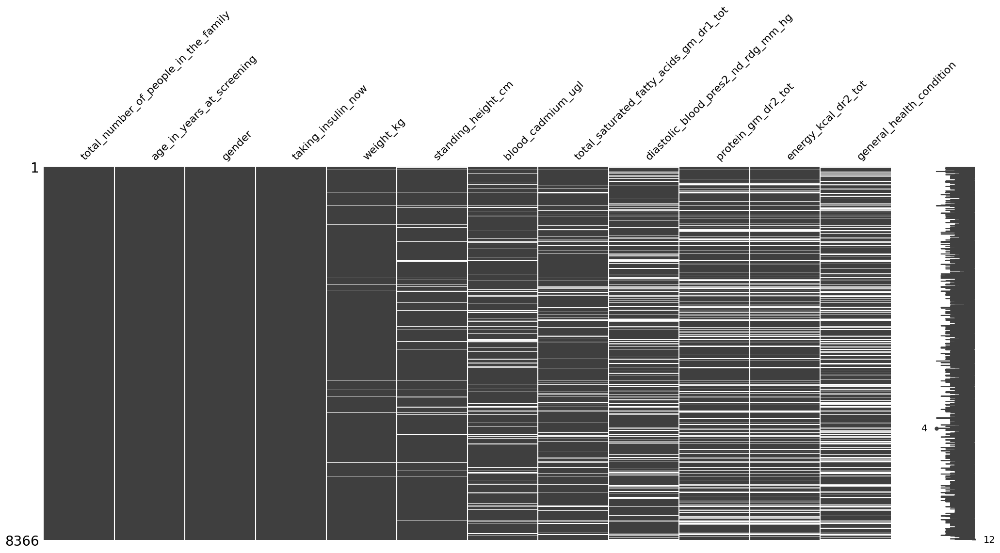

In [8]:
nhanes_group_1_df.pipe(missingno.matrix)
plt.show()

Tenemos datos nulos implicitos en total_saturated_fatty_acids_gm_dr1_tot, diastolic_blood_pres2_nd_rdg_mm_hg, protein_gm_dr2_tot, energy_kcal_dr2_tot dado que hay valores demasiado pequeños, vamos a remplazarlos con np.nan

In [9]:
# Tenemos datos nulos implicitos en total_saturated_fatty_acids_gm_dr1_tot, diastolic_blood_pres2_nd_rdg_mm_hg, protein_gm_dr2_tot, energy_kcal_dr2_tot dado que hay valores demasiado pequeños, vamos a remplazarlos con np.nan
nhanes_group_1_df_unmasked1 = nhanes_group_1_df.copy()
nhanes_group_1_df_unmasked1[[
    "total_saturated_fatty_acids_gm_dr1_tot",
    "diastolic_blood_pres2_nd_rdg_mm_hg",
    "protein_gm_dr2_tot",
    "energy_kcal_dr2_tot",
    ]] = nhanes_group_1_df[[
    "total_saturated_fatty_acids_gm_dr1_tot",
    "diastolic_blood_pres2_nd_rdg_mm_hg",
    "protein_gm_dr2_tot",
    "energy_kcal_dr2_tot"
]].applymap(lambda x: np.nan if x < 0.00001 else x)

In [10]:
# Revisemos de nuevo
nhanes_group_1_df_unmasked1.describe()

,age_in_years_at_screening,taking_insulin_now,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot
count,8366.000000,8365.000000,8242.000000,8016.000000,7513.000000,7280.000000,6439.000000,6320.000000,6321.000000
mean,35.830026,0.029528,67.499260,156.593401,0.373626,26.584440,69.613605,70.900144,1832.806518
std,24.905061,0.169291,31.377152,22.257858,0.503434,17.057148,13.214075,38.407472,885.745079
min,1.000000,0.000000,8.300000,78.300000,0.070000,0.029000,2.000000,0.120000,19.000000
25%,12.000000,0.000000,48.700000,151.400000,0.120000,15.002000,62.000000,45.000000,1227.000000
50%,33.000000,0.000000,69.200000,161.900000,0.220000,23.043500,70.000000,63.830000,1699.000000
75%,59.000000,0.000000,86.500000,171.200000,0.420000,34.393750,78.000000,88.100000,2262.000000
max,80.000000,1.000000,242.600000,197.700000,13.030000,195.852000,136.000000,345.530000,11241.000000


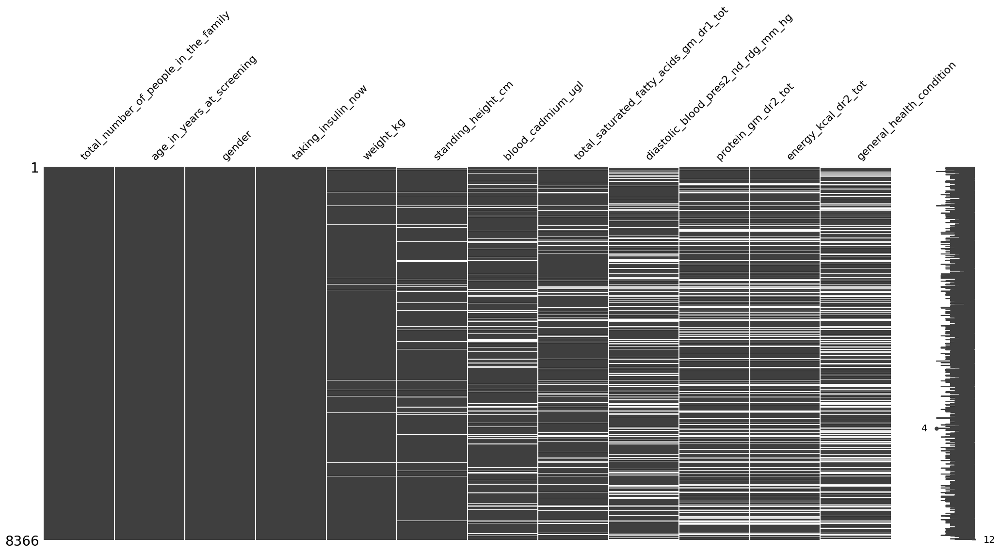

In [11]:
nhanes_group_1_df_unmasked1.pipe(missingno.matrix)
plt.show()

In [12]:
# Revisemos si taking insulin now tiene valores nulos
nhanes_group_1_df_unmasked1["taking_insulin_now"].isnull().sum()

1

In [13]:
nhanes_group_1_df_unmasked1.describe(include="all")

,total_number_of_people_in_the_family,age_in_years_at_screening,gender,taking_insulin_now,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,general_health_condition
count,8366,8366.000000,8366,8365.000000,8242.000000,8016.000000,7513.000000,7280.000000,6439.000000,6320.000000,6321.000000,5964
unique,7,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5
top,4,NaN,Female,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Good
freq,1658,NaN,4272,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2454
mean,NaN,35.830026,NaN,0.029528,67.499260,156.593401,0.373626,26.584440,69.613605,70.900144,1832.806518,NaN
std,NaN,24.905061,NaN,0.169291,31.377152,22.257858,0.503434,17.057148,13.214075,38.407472,885.745079,NaN
min,NaN,1.000000,NaN,0.000000,8.300000,78.300000,0.070000,0.029000,2.000000,0.120000,19.000000,NaN
25%,NaN,12.000000,NaN,0.000000,48.700000,151.400000,0.120000,15.002000,62.000000,45.000000,1227.000000,NaN
50%,NaN,33.000000,NaN,0.000000,69.200000,161.900000,0.220000,23.043500,70.000000,63.830000,1699.000000,NaN
75%,NaN,59.000000,NaN,0.000000,86.500000,171.200000,0.420000,34.393750,78.000000,88.100000,2262.000000,NaN


La columna taking_insulin_now se puede inferir que es una variable categorica, vamos a convertirla a categorica

In [14]:
nhanes_group_1_df_unmasked2 = nhanes_group_1_df_unmasked1.copy()
nhanes_group_1_df_unmasked2["taking_insulin_now"] = nhanes_group_1_df_unmasked2["taking_insulin_now"].astype("object")

Describamos los datos categoricos

In [15]:
nhanes_group_1_df_unmasked2.describe(include='object')

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition
count,8366,8366,8365.0,5964
unique,7,2,2.0,5
top,4,Female,0.0,Good
freq,1658,4272,8118.0,2454


In [16]:
#Mostremos todos los nulos de cada variable
nhanes_group_1_df_unmasked2.isnull().sum()

total_number_of_people_in_the_family         0
age_in_years_at_screening                    0
gender                                       0
taking_insulin_now                           1
weight_kg                                  124
standing_height_cm                         350
blood_cadmium_ugl                          853
total_saturated_fatty_acids_gm_dr1_tot    1086
diastolic_blood_pres2_nd_rdg_mm_hg        1927
protein_gm_dr2_tot                        2046
energy_kcal_dr2_tot                       2045
general_health_condition                  2402
dtype: int64

Punto 2

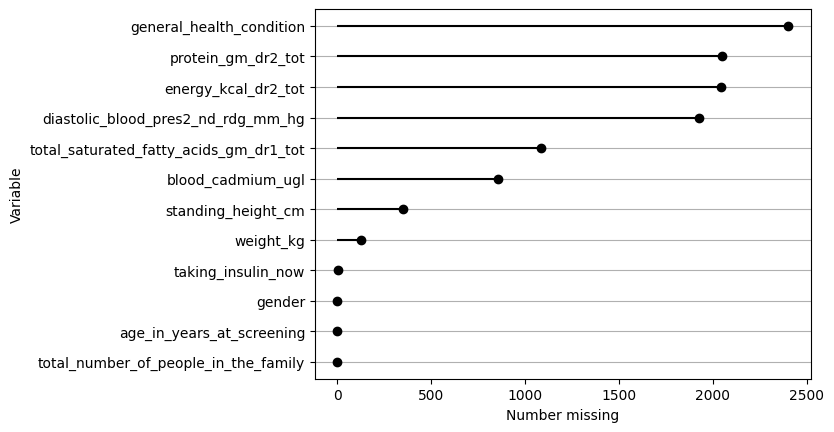

In [17]:
nhanes_group_1_df_unmasked2.missing.missing_variable_plot()

Observamos que las variables con más datos nulos son general_health_condition, protein_gm_dr2_tot, energy_kcal_dr2_tot

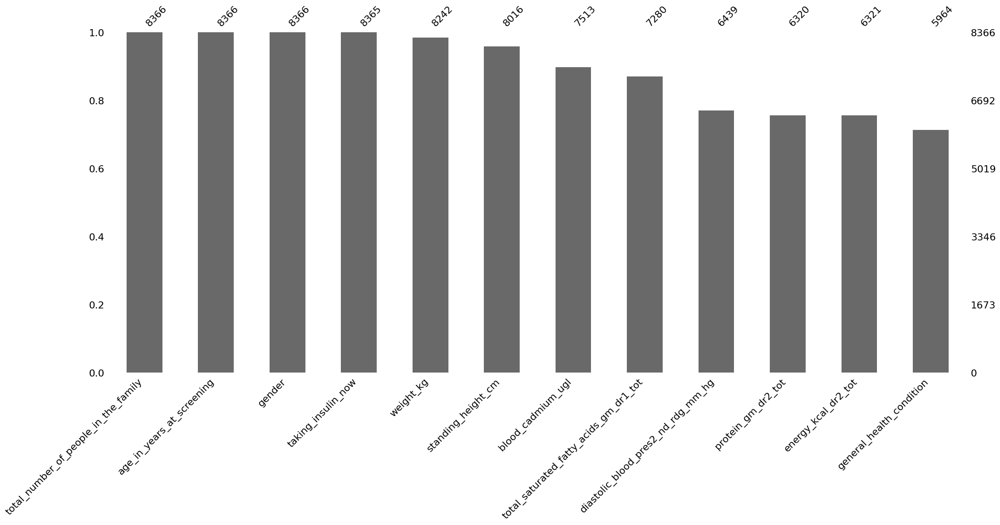

In [18]:
missingno.bar(nhanes_group_1_df_unmasked2)
plt.show()

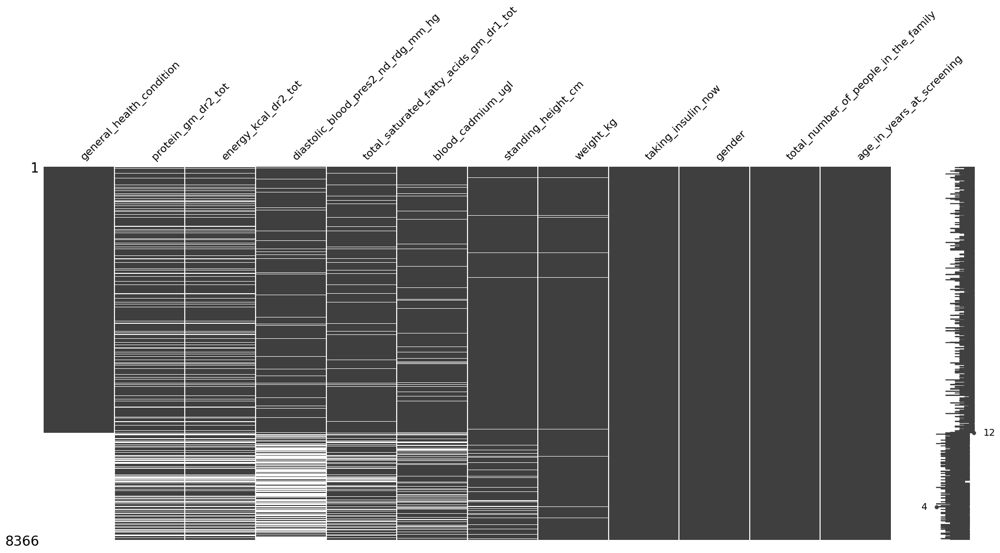

In [19]:
nhanes_group_1_df_unmasked2.missing.sort_variables_by_missingness().sort_values(by="general_health_condition").pipe(missingno.matrix)
plt.show()

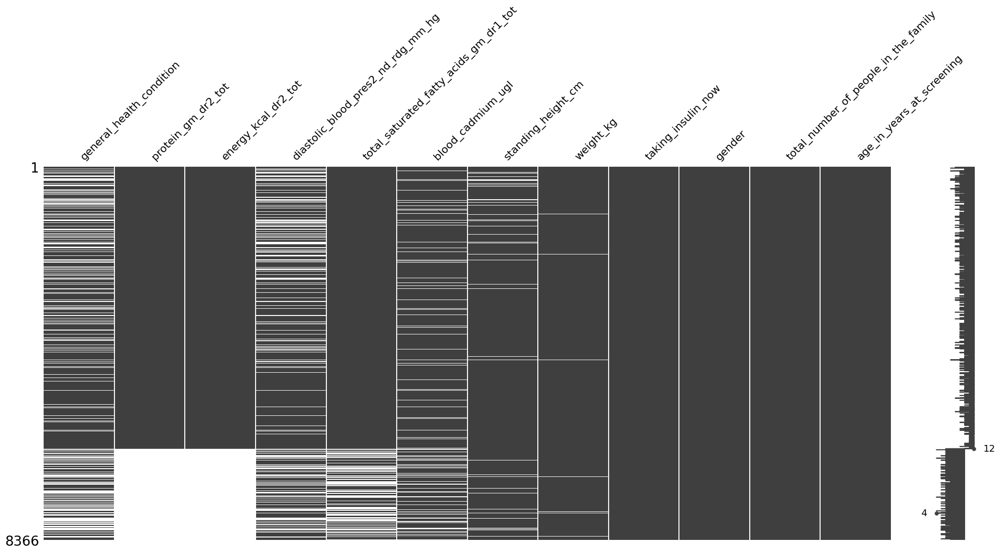

In [20]:
nhanes_group_1_df_unmasked2.missing.sort_variables_by_missingness().sort_values(by="energy_kcal_dr2_tot").pipe(missingno.matrix)
plt.show()

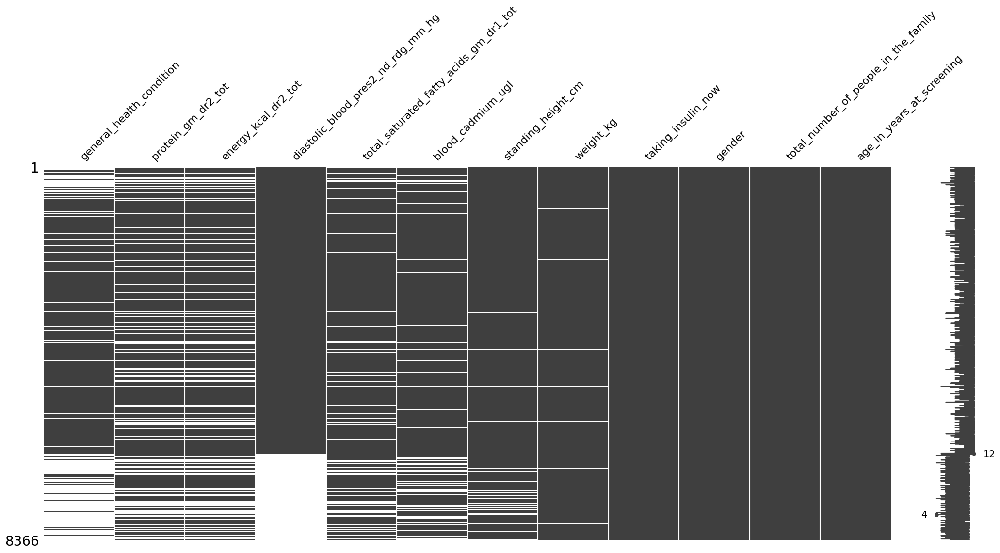

In [21]:
nhanes_group_1_df_unmasked2.missing.sort_variables_by_missingness().sort_values(by="diastolic_blood_pres2_nd_rdg_mm_hg").pipe(missingno.matrix)
plt.show()

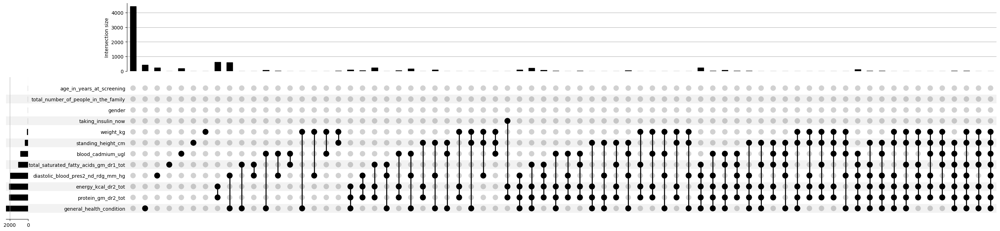

In [22]:
nhanes_group_1_df_unmasked2.missing.missing_upsetplot(variables=None)
plt.show()

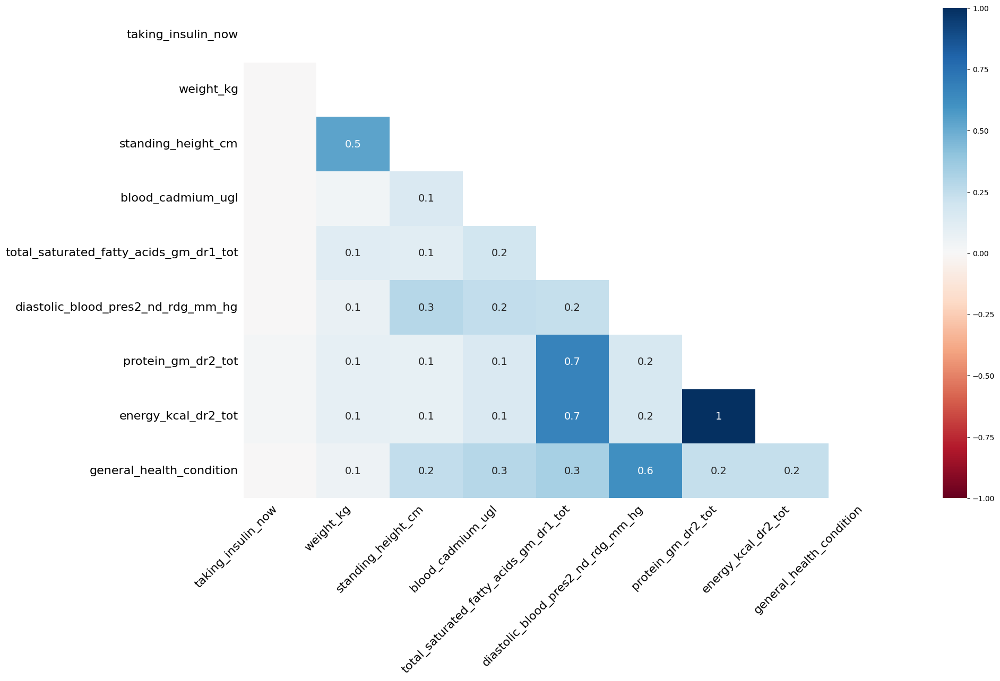

In [23]:
missingno.heatmap(nhanes_group_1_df_unmasked2)
plt.show()

<Axes: >

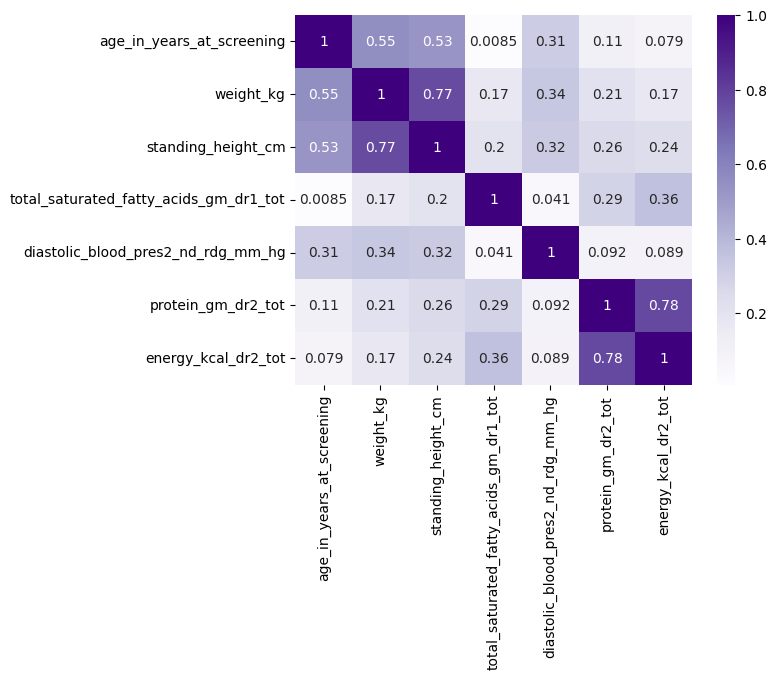

In [24]:
categorical = ['total_number_of_people_in_the_family', 'blood_cadmium_ugl', 'general_health_condition', 'taking_insulin_now', 'gender']
sb.heatmap(nhanes_group_1_df_unmasked2.drop(columns=categorical).corr(), annot=True, cmap='Purples')

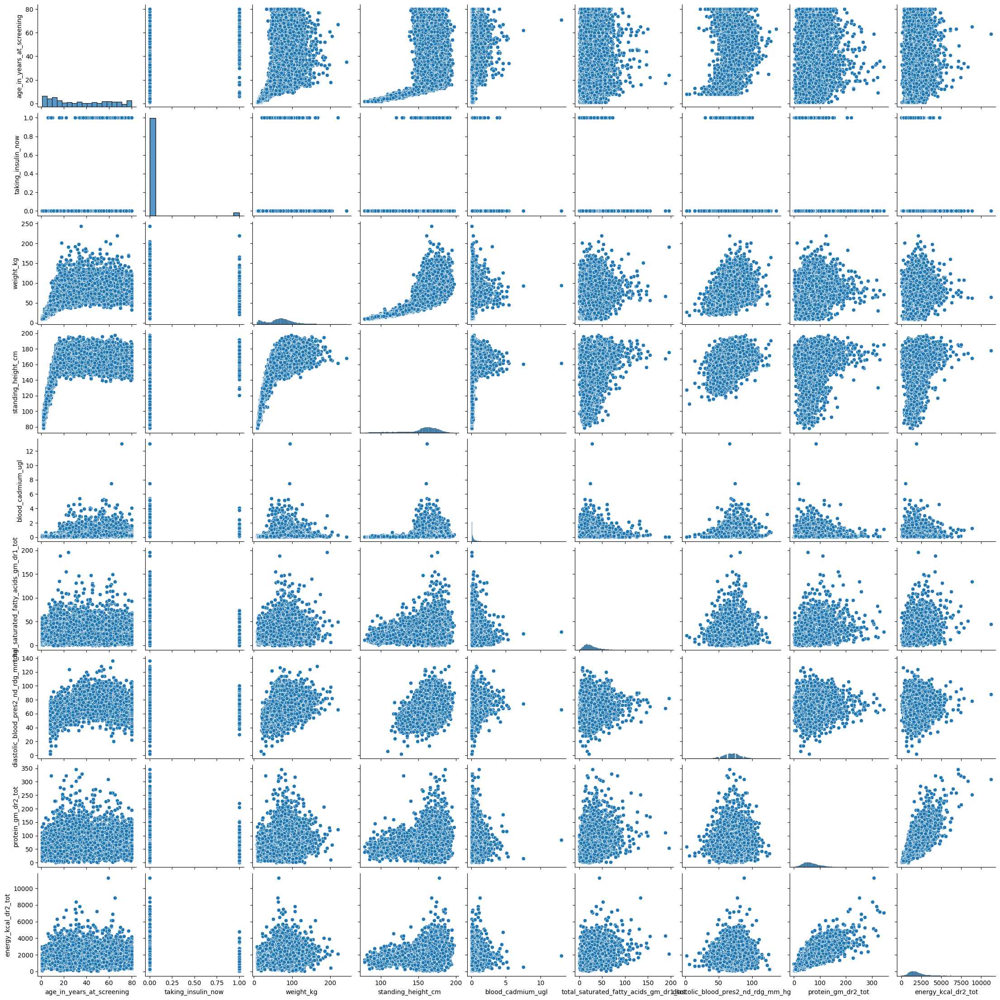

In [25]:
sb.pairplot(data=nhanes_group_1_df_unmasked2, kind='scatter')

Se puede observar que hay patrones importantes que siguen un común en datos nulos que son:

- La variable general_health_condition siendo la única variable con datos nulos
- La variable diastolic_blood_pres2_nd_rdg_mm_hg siendo la única variable con datos nulos
- Las variables protein_gm_dr2_tot y energy_kcal_dr2_tot tienen datos nulos en las mismas filas
- Las variables general_health_condition y total_saturated_fatty_acids_gm_dr1_tot tienen datos nulos en las mismas filas
- Las variables protein_gm_dr2_tot y total_saturated_fatty_acids_gm_dr1_tot tienen datos nulos en las mismas filas
- Todas filas que tengan energy nula van a tener protein nula


*La base de datos tiene datos nulos implícitos* que son:
- "total_saturated_fatty_acids_gm_dr1_tot"
- "diastolic_blood_pres2_nd_rdg_mm_hg"
- "protein_gm_dr2_tot"
- "energy_kcal_dr2_tot"

# Vamos a imputar los datos nulos

## Imputación simple

In [26]:
from scipy.stats import chi2_contingency


Vamos a eliminar el unico registro nulo de taking insulin now

In [27]:
data1 = nhanes_group_1_df_unmasked2.dropna(subset=['taking_insulin_now'])
data1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8365 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8365 non-null   object 
 1   age_in_years_at_screening               8365 non-null   float64
 2   gender                                  8365 non-null   object 
 3   taking_insulin_now                      8365 non-null   object 
 4   weight_kg                               8241 non-null   float64
 5   standing_height_cm                      8015 non-null   float64
 6   blood_cadmium_ugl                       7512 non-null   float64
 7   total_saturated_fatty_acids_gm_dr1_tot  7279 non-null   float64
 8   diastolic_blood_pres2_nd_rdg_mm_hg      6438 non-null   float64
 9   protein_gm_dr2_tot                      6320 non-null   float64
 10  energy_kcal_dr2_tot                     6321 non-null  

Vamos a eliminar registros que todas las que tienen nulos sean nulas

In [28]:
data1.dropna(subset=['protein_gm_dr2_tot', 'energy_kcal_dr2_tot', 'diastolic_blood_pres2_nd_rdg_mm_hg','total_saturated_fatty_acids_gm_dr1_tot', 'blood_cadmium_ugl', 'general_health_condition', 'weight_kg', 'standing_height_cm'], how = 'all', inplace=True)
data1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8360 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8360 non-null   object 
 1   age_in_years_at_screening               8360 non-null   float64
 2   gender                                  8360 non-null   object 
 3   taking_insulin_now                      8360 non-null   object 
 4   weight_kg                               8241 non-null   float64
 5   standing_height_cm                      8015 non-null   float64
 6   blood_cadmium_ugl                       7512 non-null   float64
 7   total_saturated_fatty_acids_gm_dr1_tot  7279 non-null   float64
 8   diastolic_blood_pres2_nd_rdg_mm_hg      6438 non-null   float64
 9   protein_gm_dr2_tot                      6320 non-null   float64
 10  energy_kcal_dr2_tot                     6321 non-null  

In [ ]:
# Vamos a llenar todos los nulos con la media de la columna correspondiente
data1_simple = data1.copy()

# Llenar los valores nulos con la media de cada columna
data1_simple = data1_simple.fillna(data1_simple.mean())

# Verificar si hay nulos restantes
print(data1_simple.isnull().sum())

# Vecinos Cercanos

In [29]:
data2 = data1.copy()

In [30]:
categorical_columns = data2.select_dtypes(include=['object']).columns
categorical_transformer = sklearn.compose.make_column_transformer((sklearn.preprocessing.OrdinalEncoder(),categorical_columns), remainder='passthrough')
categorical_transformer

ColumnTransformer(remainder='passthrough',
                  transformers=[('ordinalencoder', OrdinalEncoder(),
                                 Index(['total_number_of_people_in_the_family', 'gender', 'taking_insulin_now',
       'general_health_condition'],
      dtype='object'))])

In [31]:
#Ejecutemos el transformador
nhanes_transformed_df = pd.DataFrame(categorical_transformer.fit_transform(data2), columns = categorical_transformer.get_feature_names_out(),
                                     index = data2.index).rename_columns(function = lambda x: x.removeprefix('ordinalencoder__'))\
                                       .rename_columns(function = lambda x: x.removeprefix('remainder__'))
                                      
nhanes_transformed_df
# Se crea un nuevo dataframe con las columnas transformadas, se transforman las columnas categoricas, a toda variable categorica se le asigna un valor numerico

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition,age_in_years_at_screening,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot
SEQN,,,,,,,,,,,,
93703.0,4.0,0.0,0.0,NaN,2.0,13.7,88.6,NaN,NaN,NaN,NaN,NaN
93704.0,3.0,1.0,0.0,NaN,2.0,13.9,94.2,0.07,11.372,NaN,30.49,1356.0
93705.0,0.0,0.0,0.0,2.0,66.0,79.5,158.3,0.24,16.435,NaN,38.52,1235.0
93706.0,4.0,1.0,0.0,4.0,18.0,66.3,175.7,0.21,35.169,70.0,NaN,NaN
93707.0,6.0,1.0,0.0,2.0,13.0,45.4,158.4,0.14,33.252,46.0,92.03,1794.0
...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,1.0,0.0,0.0,4.0,70.0,49.0,156.5,0.61,7.652,78.0,47.56,1054.0
102953.0,0.0,1.0,0.0,1.0,42.0,97.4,164.9,0.21,25.831,76.0,NaN,NaN
102954.0,6.0,0.0,0.0,2.0,41.0,69.1,162.6,0.32,20.526,72.0,66.97,1835.0


In [32]:
knn_imputer = sklearn.impute.KNNImputer() # 3 vecinos por defecto, se sugiere que sea impar
nhanes_knn_df = pd.DataFrame(knn_imputer.fit_transform(nhanes_transformed_df).round(), columns = nhanes_transformed_df.columns, index = nhanes_transformed_df.index)
nhanes_knn_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8360 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8360 non-null   float64
 1   gender                                  8360 non-null   float64
 2   taking_insulin_now                      8360 non-null   float64
 3   general_health_condition                8360 non-null   float64
 4   age_in_years_at_screening               8360 non-null   float64
 5   weight_kg                               8360 non-null   float64
 6   standing_height_cm                      8360 non-null   float64
 7   blood_cadmium_ugl                       8360 non-null   float64
 8   total_saturated_fatty_acids_gm_dr1_tot  8360 non-null   float64
 9   diastolic_blood_pres2_nd_rdg_mm_hg      8360 non-null   float64
 10  protein_gm_dr2_tot                      8360 non-null  

In [33]:
knn_imputer_shadow_matrix = pd.concat([nhanes_knn_df, data2.missing.create_shadow_matrix(True,False, suffix='_imp', only_missing=True)],axis=1)
knn_imputer_shadow_matrix

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition,age_in_years_at_screening,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,weight_kg_imp,standing_height_cm_imp,blood_cadmium_ugl_imp,total_saturated_fatty_acids_gm_dr1_tot_imp,diastolic_blood_pres2_nd_rdg_mm_hg_imp,protein_gm_dr2_tot_imp,energy_kcal_dr2_tot_imp,general_health_condition_imp
SEQN,,,,,,,,,,,,,,,,,,,,
93703.0,4.0,0.0,0.0,2.0,2.0,14.0,89.0,0.0,21.0,54.0,41.0,1275.0,False,False,True,True,True,True,True,True
93704.0,3.0,1.0,0.0,2.0,2.0,14.0,94.0,0.0,11.0,54.0,30.0,1356.0,False,False,False,False,True,False,False,True
93705.0,0.0,0.0,0.0,2.0,66.0,80.0,158.0,0.0,16.0,87.0,39.0,1235.0,False,False,False,False,True,False,False,False
93706.0,4.0,1.0,0.0,4.0,18.0,66.0,176.0,0.0,35.0,70.0,118.0,2081.0,False,False,False,False,False,True,True,False
93707.0,6.0,1.0,0.0,2.0,13.0,45.0,158.0,0.0,33.0,46.0,92.0,1794.0,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,1.0,0.0,0.0,4.0,70.0,49.0,156.0,1.0,8.0,78.0,48.0,1054.0,False,False,False,False,False,False,False,False
102953.0,0.0,1.0,0.0,1.0,42.0,97.0,165.0,0.0,26.0,76.0,73.0,1607.0,False,False,False,False,False,True,True,False
102954.0,6.0,0.0,0.0,2.0,41.0,69.0,163.0,0.0,21.0,72.0,67.0,1835.0,False,False,False,False,False,False,False,False


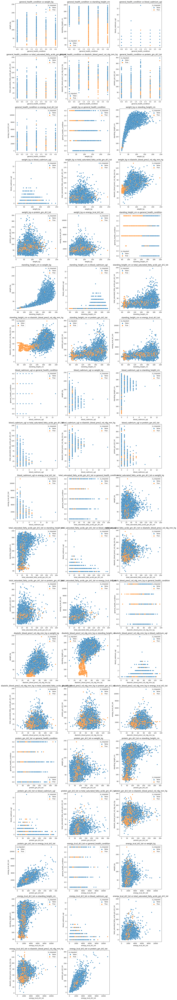

In [34]:

# Contar cuántas combinaciones de columnas cumplen la condición
valid_combinations = [
    (i, j) for i in knn_imputer_shadow_matrix.columns 
    for j in knn_imputer_shadow_matrix.columns
    if i != j and not i.endswith('_imp') and not j.endswith('_imp') and 
    {i, j, f"{i}_imp", f"{j}_imp"}.issubset(knn_imputer_shadow_matrix.columns)
]

# Definir el tamaño del grid
n_combinations = len(valid_combinations)
n_cols = 3  # Número de columnas en el grid
n_rows = int(np.ceil(n_combinations / n_cols))  # Número de filas en el grid

# Crear un grid de subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Aplanar la matriz de ejes para iterar más fácilmente

for idx, (i, j) in enumerate(valid_combinations):
    knn_imputer_shadow_matrix.missing.scatter_imputation_plot(x=i, y=j, ax=axes[idx])
    axes[idx].set_title(f'{i} vs {j}')

# Ocultar subplots vacíos si es necesario
for ax in axes[n_combinations:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

## MICE – Regresión Lineal (LinearRegression)

In [35]:
mice_imputer_linear = sklearn.impute.IterativeImputer(estimator=LinearRegression(), initial_strategy="mean", max_iter=10)
nhanes_mice_df_linear = pd.DataFrame(mice_imputer_linear.fit_transform(nhanes_transformed_df).round(), columns = nhanes_transformed_df.columns, index = nhanes_transformed_df.index)
nhanes_mice_df_linear.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8360 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8360 non-null   float64
 1   gender                                  8360 non-null   float64
 2   taking_insulin_now                      8360 non-null   float64
 3   general_health_condition                8360 non-null   float64
 4   age_in_years_at_screening               8360 non-null   float64
 5   weight_kg                               8360 non-null   float64
 6   standing_height_cm                      8360 non-null   float64
 7   blood_cadmium_ugl                       8360 non-null   float64
 8   total_saturated_fatty_acids_gm_dr1_tot  8360 non-null   float64
 9   diastolic_blood_pres2_nd_rdg_mm_hg      8360 non-null   float64
 10  protein_gm_dr2_tot                      8360 non-null  

In [36]:
knn_imputer_shadow_matrix = pd.concat([nhanes_mice_df_linear, data2.missing.create_shadow_matrix(True,False, suffix='_imp', only_missing=True)],axis=1)
knn_imputer_shadow_matrix

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition,age_in_years_at_screening,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,weight_kg_imp,standing_height_cm_imp,blood_cadmium_ugl_imp,total_saturated_fatty_acids_gm_dr1_tot_imp,diastolic_blood_pres2_nd_rdg_mm_hg_imp,protein_gm_dr2_tot_imp,energy_kcal_dr2_tot_imp,general_health_condition_imp
SEQN,,,,,,,,,,,,,,,,,,,,
93703.0,4.0,0.0,0.0,2.0,2.0,14.0,89.0,0.0,15.0,43.0,37.0,1067.0,False,False,True,True,True,True,True,True
93704.0,3.0,1.0,0.0,2.0,2.0,14.0,94.0,0.0,11.0,43.0,30.0,1356.0,False,False,False,False,True,False,False,True
93705.0,0.0,0.0,0.0,2.0,66.0,80.0,158.0,0.0,16.0,72.0,39.0,1235.0,False,False,False,False,True,False,False,False
93706.0,4.0,1.0,0.0,4.0,18.0,66.0,176.0,0.0,35.0,70.0,87.0,2246.0,False,False,False,False,False,True,True,False
93707.0,6.0,1.0,0.0,2.0,13.0,45.0,158.0,0.0,33.0,46.0,92.0,1794.0,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,1.0,0.0,0.0,4.0,70.0,49.0,156.0,1.0,8.0,78.0,48.0,1054.0,False,False,False,False,False,False,False,False
102953.0,0.0,1.0,0.0,1.0,42.0,97.0,165.0,0.0,26.0,76.0,83.0,2043.0,False,False,False,False,False,True,True,False
102954.0,6.0,0.0,0.0,2.0,41.0,69.0,163.0,0.0,21.0,72.0,67.0,1835.0,False,False,False,False,False,False,False,False


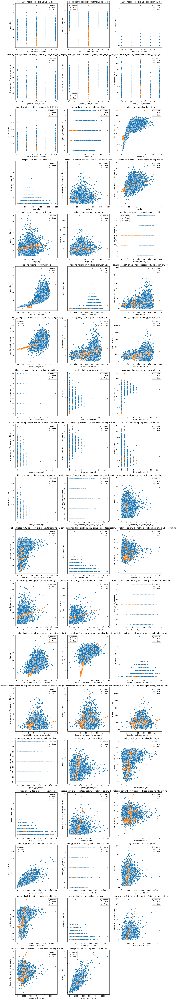

In [37]:

# Contar cuántas combinaciones de columnas cumplen la condición
valid_combinations = [
    (i, j) for i in knn_imputer_shadow_matrix.columns 
    for j in knn_imputer_shadow_matrix.columns
    if i != j and not i.endswith('_imp') and not j.endswith('_imp') and 
    {i, j, f"{i}_imp", f"{j}_imp"}.issubset(knn_imputer_shadow_matrix.columns)
]

# Definir el tamaño del grid
n_combinations = len(valid_combinations)
n_cols = 3  # Número de columnas en el grid
n_rows = int(np.ceil(n_combinations / n_cols))  # Número de filas en el grid

# Crear un grid de subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Aplanar la matriz de ejes para iterar más fácilmente

for idx, (i, j) in enumerate(valid_combinations):
    knn_imputer_shadow_matrix.missing.scatter_imputation_plot(x=i, y=j, ax=axes[idx])
    axes[idx].set_title(f'{i} vs {j}')

# Ocultar subplots vacíos si es necesario
for ax in axes[n_combinations:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

## MICE – Árbol de Decisión (DecissiónTreeRegressor) 

In [38]:
mice_imputer_tree_regressor = sklearn.impute.IterativeImputer(estimator=DecisionTreeRegressor(), initial_strategy="mean", max_iter=10)
nhanes_mice_df_tree_regressor = pd.DataFrame(mice_imputer_tree_regressor.fit_transform(nhanes_transformed_df).round(), columns = nhanes_transformed_df.columns, index = nhanes_transformed_df.index)
nhanes_mice_df_tree_regressor.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8360 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8360 non-null   float64
 1   gender                                  8360 non-null   float64
 2   taking_insulin_now                      8360 non-null   float64
 3   general_health_condition                8360 non-null   float64
 4   age_in_years_at_screening               8360 non-null   float64
 5   weight_kg                               8360 non-null   float64
 6   standing_height_cm                      8360 non-null   float64
 7   blood_cadmium_ugl                       8360 non-null   float64
 8   total_saturated_fatty_acids_gm_dr1_tot  8360 non-null   float64
 9   diastolic_blood_pres2_nd_rdg_mm_hg      8360 non-null   float64
 10  protein_gm_dr2_tot                      8360 non-null  

In [39]:
knn_imputer_shadow_matrix = pd.concat([nhanes_mice_df_tree_regressor, data2.missing.create_shadow_matrix(True,False, suffix='_imp', only_missing=True)],axis=1)
knn_imputer_shadow_matrix

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition,age_in_years_at_screening,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,weight_kg_imp,standing_height_cm_imp,blood_cadmium_ugl_imp,total_saturated_fatty_acids_gm_dr1_tot_imp,diastolic_blood_pres2_nd_rdg_mm_hg_imp,protein_gm_dr2_tot_imp,energy_kcal_dr2_tot_imp,general_health_condition_imp
SEQN,,,,,,,,,,,,,,,,,,,,
93703.0,4.0,0.0,0.0,0.0,2.0,14.0,89.0,0.0,10.0,6.0,69.0,1695.0,False,False,True,True,True,True,True,True
93704.0,3.0,1.0,0.0,4.0,2.0,14.0,94.0,0.0,11.0,6.0,30.0,1356.0,False,False,False,False,True,False,False,True
93705.0,0.0,0.0,0.0,2.0,66.0,80.0,158.0,0.0,16.0,74.0,39.0,1235.0,False,False,False,False,True,False,False,False
93706.0,4.0,1.0,0.0,4.0,18.0,66.0,176.0,0.0,35.0,70.0,40.0,1348.0,False,False,False,False,False,True,True,False
93707.0,6.0,1.0,0.0,2.0,13.0,45.0,158.0,0.0,33.0,46.0,92.0,1794.0,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,1.0,0.0,0.0,4.0,70.0,49.0,156.0,1.0,8.0,78.0,48.0,1054.0,False,False,False,False,False,False,False,False
102953.0,0.0,1.0,0.0,1.0,42.0,97.0,165.0,0.0,26.0,76.0,123.0,1903.0,False,False,False,False,False,True,True,False
102954.0,6.0,0.0,0.0,2.0,41.0,69.0,163.0,0.0,21.0,72.0,67.0,1835.0,False,False,False,False,False,False,False,False


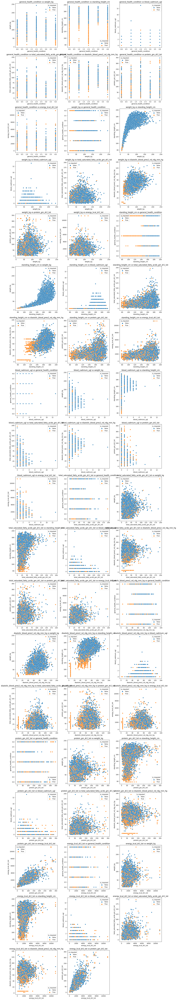

In [40]:

# Contar cuántas combinaciones de columnas cumplen la condición
valid_combinations = [
    (i, j) for i in knn_imputer_shadow_matrix.columns 
    for j in knn_imputer_shadow_matrix.columns
    if i != j and not i.endswith('_imp') and not j.endswith('_imp') and 
    {i, j, f"{i}_imp", f"{j}_imp"}.issubset(knn_imputer_shadow_matrix.columns)
]

# Definir el tamaño del grid
n_combinations = len(valid_combinations)
n_cols = 3  # Número de columnas en el grid
n_rows = int(np.ceil(n_combinations / n_cols))  # Número de filas en el grid

# Crear un grid de subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Aplanar la matriz de ejes para iterar más fácilmente

for idx, (i, j) in enumerate(valid_combinations):
    knn_imputer_shadow_matrix.missing.scatter_imputation_plot(x=i, y=j, ax=axes[idx])
    axes[idx].set_title(f'{i} vs {j}')

# Ocultar subplots vacíos si es necesario
for ax in axes[n_combinations:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

## MICE – Bosque Aleatorio (RandomForestRegressor)

In [41]:
mice_imputer_forest_random = sklearn.impute.IterativeImputer(estimator=RandomForestRegressor(), initial_strategy="mean", max_iter=10)
nhanes_mice_df_forest_random = pd.DataFrame(mice_imputer_forest_random.fit_transform(nhanes_transformed_df).round(), columns = nhanes_transformed_df.columns, index = nhanes_transformed_df.index)
nhanes_mice_df_forest_random.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8360 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8360 non-null   float64
 1   gender                                  8360 non-null   float64
 2   taking_insulin_now                      8360 non-null   float64
 3   general_health_condition                8360 non-null   float64
 4   age_in_years_at_screening               8360 non-null   float64
 5   weight_kg                               8360 non-null   float64
 6   standing_height_cm                      8360 non-null   float64
 7   blood_cadmium_ugl                       8360 non-null   float64
 8   total_saturated_fatty_acids_gm_dr1_tot  8360 non-null   float64
 9   diastolic_blood_pres2_nd_rdg_mm_hg      8360 non-null   float64
 10  protein_gm_dr2_tot                      8360 non-null  

In [42]:
knn_imputer_shadow_matrix = pd.concat([nhanes_mice_df_forest_random, data2.missing.create_shadow_matrix(True,False, suffix='_imp', only_missing=True)],axis=1)
knn_imputer_shadow_matrix

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition,age_in_years_at_screening,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,weight_kg_imp,standing_height_cm_imp,blood_cadmium_ugl_imp,total_saturated_fatty_acids_gm_dr1_tot_imp,diastolic_blood_pres2_nd_rdg_mm_hg_imp,protein_gm_dr2_tot_imp,energy_kcal_dr2_tot_imp,general_health_condition_imp
SEQN,,,,,,,,,,,,,,,,,,,,
93703.0,4.0,0.0,0.0,1.0,2.0,14.0,89.0,0.0,21.0,50.0,52.0,1445.0,False,False,True,True,True,True,True,True
93704.0,3.0,1.0,0.0,3.0,2.0,14.0,94.0,0.0,11.0,20.0,30.0,1356.0,False,False,False,False,True,False,False,True
93705.0,0.0,0.0,0.0,2.0,66.0,80.0,158.0,0.0,16.0,70.0,39.0,1235.0,False,False,False,False,True,False,False,False
93706.0,4.0,1.0,0.0,4.0,18.0,66.0,176.0,0.0,35.0,70.0,94.0,2418.0,False,False,False,False,False,True,True,False
93707.0,6.0,1.0,0.0,2.0,13.0,45.0,158.0,0.0,33.0,46.0,92.0,1794.0,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,1.0,0.0,0.0,4.0,70.0,49.0,156.0,1.0,8.0,78.0,48.0,1054.0,False,False,False,False,False,False,False,False
102953.0,0.0,1.0,0.0,1.0,42.0,97.0,165.0,0.0,26.0,76.0,81.0,2199.0,False,False,False,False,False,True,True,False
102954.0,6.0,0.0,0.0,2.0,41.0,69.0,163.0,0.0,21.0,72.0,67.0,1835.0,False,False,False,False,False,False,False,False


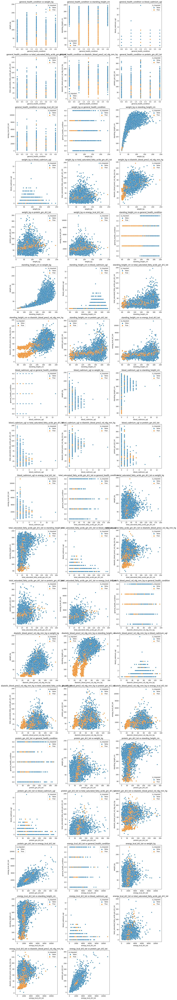

In [43]:

# Contar cuántas combinaciones de columnas cumplen la condición
valid_combinations = [
    (i, j) for i in knn_imputer_shadow_matrix.columns 
    for j in knn_imputer_shadow_matrix.columns
    if i != j and not i.endswith('_imp') and not j.endswith('_imp') and 
    {i, j, f"{i}_imp", f"{j}_imp"}.issubset(knn_imputer_shadow_matrix.columns)
]

# Definir el tamaño del grid
n_combinations = len(valid_combinations)
n_cols = 3  # Número de columnas en el grid
n_rows = int(np.ceil(n_combinations / n_cols))  # Número de filas en el grid

# Crear un grid de subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Aplanar la matriz de ejes para iterar más fácilmente

for idx, (i, j) in enumerate(valid_combinations):
    knn_imputer_shadow_matrix.missing.scatter_imputation_plot(x=i, y=j, ax=axes[idx])
    axes[idx].set_title(f'{i} vs {j}')

# Ocultar subplots vacíos si es necesario
for ax in axes[n_combinations:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

## MICE – Red Neuronal Perceptrón (MLPRegresssor) 

In [44]:
mice_imputer_mlp_regressor = sklearn.impute.IterativeImputer(estimator=MLPRegressor(), initial_strategy="mean", max_iter=10)
nhanes_mice_df_mlp_regressor= pd.DataFrame(mice_imputer_mlp_regressor.fit_transform(nhanes_transformed_df).round(), columns = nhanes_transformed_df.columns, index = nhanes_transformed_df.index)
nhanes_mice_df_mlp_regressor.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8360 entries, 93703.0 to 102956.0
Data columns (total 12 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   total_number_of_people_in_the_family    8360 non-null   float64
 1   gender                                  8360 non-null   float64
 2   taking_insulin_now                      8360 non-null   float64
 3   general_health_condition                8360 non-null   float64
 4   age_in_years_at_screening               8360 non-null   float64
 5   weight_kg                               8360 non-null   float64
 6   standing_height_cm                      8360 non-null   float64
 7   blood_cadmium_ugl                       8360 non-null   float64
 8   total_saturated_fatty_acids_gm_dr1_tot  8360 non-null   float64
 9   diastolic_blood_pres2_nd_rdg_mm_hg      8360 non-null   float64
 10  protein_gm_dr2_tot                      8360 non-null  

In [45]:
knn_imputer_shadow_matrix = pd.concat([nhanes_mice_df_mlp_regressor, data2.missing.create_shadow_matrix(True,False, suffix='_imp', only_missing=True)],axis=1)
knn_imputer_shadow_matrix

,total_number_of_people_in_the_family,gender,taking_insulin_now,general_health_condition,age_in_years_at_screening,weight_kg,standing_height_cm,blood_cadmium_ugl,total_saturated_fatty_acids_gm_dr1_tot,diastolic_blood_pres2_nd_rdg_mm_hg,protein_gm_dr2_tot,energy_kcal_dr2_tot,weight_kg_imp,standing_height_cm_imp,blood_cadmium_ugl_imp,total_saturated_fatty_acids_gm_dr1_tot_imp,diastolic_blood_pres2_nd_rdg_mm_hg_imp,protein_gm_dr2_tot_imp,energy_kcal_dr2_tot_imp,general_health_condition_imp
SEQN,,,,,,,,,,,,,,,,,,,,
93703.0,4.0,0.0,0.0,1.0,2.0,14.0,89.0,0.0,15.0,33.0,42.0,1124.0,False,False,True,True,True,True,True,True
93704.0,3.0,1.0,0.0,1.0,2.0,14.0,94.0,0.0,11.0,34.0,30.0,1356.0,False,False,False,False,True,False,False,True
93705.0,0.0,0.0,0.0,2.0,66.0,80.0,158.0,0.0,16.0,71.0,39.0,1235.0,False,False,False,False,True,False,False,False
93706.0,4.0,1.0,0.0,4.0,18.0,66.0,176.0,0.0,35.0,70.0,92.0,2333.0,False,False,False,False,False,True,True,False
93707.0,6.0,1.0,0.0,2.0,13.0,45.0,158.0,0.0,33.0,46.0,92.0,1794.0,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102952.0,1.0,0.0,0.0,4.0,70.0,49.0,156.0,1.0,8.0,78.0,48.0,1054.0,False,False,False,False,False,False,False,False
102953.0,0.0,1.0,0.0,1.0,42.0,97.0,165.0,0.0,26.0,76.0,86.0,2021.0,False,False,False,False,False,True,True,False
102954.0,6.0,0.0,0.0,2.0,41.0,69.0,163.0,0.0,21.0,72.0,67.0,1835.0,False,False,False,False,False,False,False,False


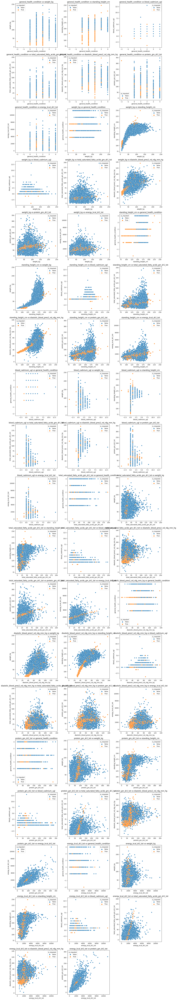

: 

In [46]:

# Contar cuántas combinaciones de columnas cumplen la condición
valid_combinations = [
    (i, j) for i in knn_imputer_shadow_matrix.columns 
    for j in knn_imputer_shadow_matrix.columns
    if i != j and not i.endswith('_imp') and not j.endswith('_imp') and 
    {i, j, f"{i}_imp", f"{j}_imp"}.issubset(knn_imputer_shadow_matrix.columns)
]

# Definir el tamaño del grid
n_combinations = len(valid_combinations)
n_cols = 3  # Número de columnas en el grid
n_rows = int(np.ceil(n_combinations / n_cols))  # Número de filas en el grid

# Crear un grid de subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()  # Aplanar la matriz de ejes para iterar más fácilmente

for idx, (i, j) in enumerate(valid_combinations):
    knn_imputer_shadow_matrix.missing.scatter_imputation_plot(x=i, y=j, ax=axes[idx])
    axes[idx].set_title(f'{i} vs {j}')

# Ocultar subplots vacíos si es necesario
for ax in axes[n_combinations:]:
    ax.axis('off')

plt.tight_layout()
plt.show()

# Observando las graficas se concluye que el mejor metodo de imputación es el de MICE – Red Neuronal Perceptrón (MLPRegresssor) 